In [1]:
import librosa, librosa.display, numpy
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
from pprint import pprint
#music synthesizer 

In [29]:
#load files
file_name = 'river_flow_in_you_beat_short_p.wav'
data, sr = librosa.load(file_name)

# data_stretch = librosa.effects.time_stretch(data, 0.9)

# data_condense = librosa.effects.time_stretch(data, 2)

file_name2 = 'just_a_dream15_80_p.wav'
data2, sr = librosa.load(file_name2)
# data2 = data2[:70*sr]

In [30]:
print(len(data), len(data2))

1336320 1433088


In [31]:
# cut and stdaretch
ipd.Audio(data, rate=sr)

In [15]:
ipd.Audio(data_stretch, rate=sr)

In [32]:
ipd.Audio(data2, rate=sr)

shape (12, 2611)
shape (12, 2800)


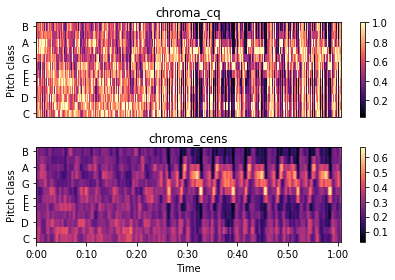

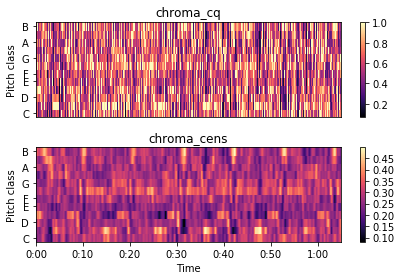

In [33]:
# calculate and plot chroma
hop_length = 256

# cut_off_time = 20 #seconds

def generate_chroma(cut_off_time, audio):
    showing = audio[:cut_off_time *sr]
    # showing =y
    result = dict()    
    result['chroma_cens'] = librosa.feature.chroma_cens(y=showing, sr=sr)
    result['chroma_cq'] = librosa.feature.chroma_cqt(y=showing, sr=sr)
    result['cqt'] = librosa.cqt(showing, sr=sr, hop_length=hop_length)
    result['cqt_mag'] = librosa.amplitude_to_db(abs(result['cqt']))
    return result
    
def plot_chroma(result):
    import matplotlib.pyplot as plt
    plt.figure()
    plt.subplot(2,1,1)
    librosa.display.specshow(result['chroma_cq'], y_axis='chroma')
    plt.title('chroma_cq')
    plt.colorbar()
    plt.subplot(2,1,2)
    librosa.display.specshow(result['chroma_cens'], y_axis='chroma', x_axis='time')
    plt.title('chroma_cens')
    plt.colorbar()
    plt.tight_layout()
    print("shape",result['chroma_cens'].shape)

data_chroma = generate_chroma(len(data), data)
data2_chroma = generate_chroma(len(data2), data2)

plot_chroma(data_chroma)
plot_chroma(data2_chroma)

# data_chroma_condense = generate_chroma(len(data_condense),data_condense)
# data_chroma_stretch = generate_chroma(len(data_stretch),data_stretch)


In [5]:
# Running DTW
import scipy, IPython.display as ipd

def dtw_instance(chroma_one, chroma_two):
    D = dtw_table(chroma_one.T, chroma_two.T, distance=scipy.spatial.distance.cityblock)
    path = dtw(chroma_one.T, chroma_two.T, D)
    print("path.shape:",path.shape)
#     i1, i2 = librosa.frames_to_samples(path[300], hop_length=hop_length)
#     print(i1, i2)
    return D, path

D_river, path_river = dtw_instance(river_chroma_condense['chroma_cens'], river_chroma['chroma_cens'])



NameError: name 'dtw_table' is not defined

In [15]:
# Run DTW functioncall from library
def librosa_dtw(X,Y, title='Database excerpt', color='y'):
    D, wp = librosa.dtw(X, Y, subseq=True)
    # plt.subplot(2, 1, 1)
    librosa.display.specshow(D, x_axis='frames', y_axis='frames')
    plt.title(title)
    plt.plot(wp[:, 1], wp[:, 0], label='Optimal path', color=color) #this will plot the Y as horizontal and X as vertical
    # plt.legend()
    # plt.subplot(2, 1, 2)
    # plt.plot(D[-1, :] / wp.shape[0])
    # plt.xlim([0, Y.shape[1]])
    # plt.ylim([0, 2])
    # plt.title('Matching cost function')
    # plt.tight_layout()
    return D,wp
    
# X = river_chroma['chroma_cens']
# Y = X


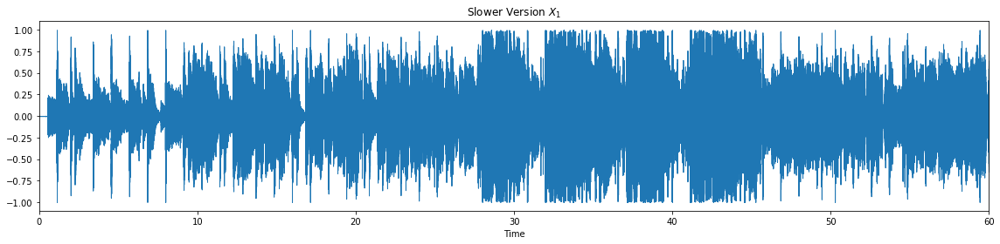

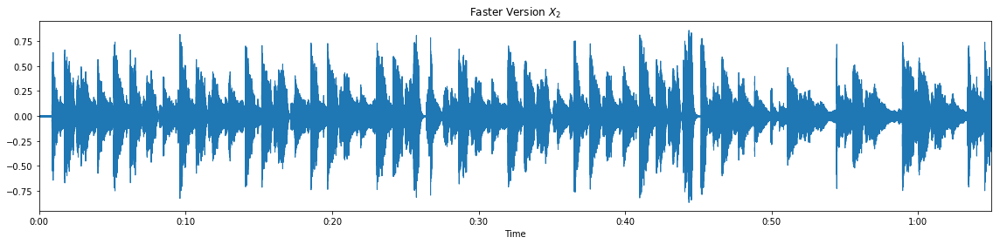

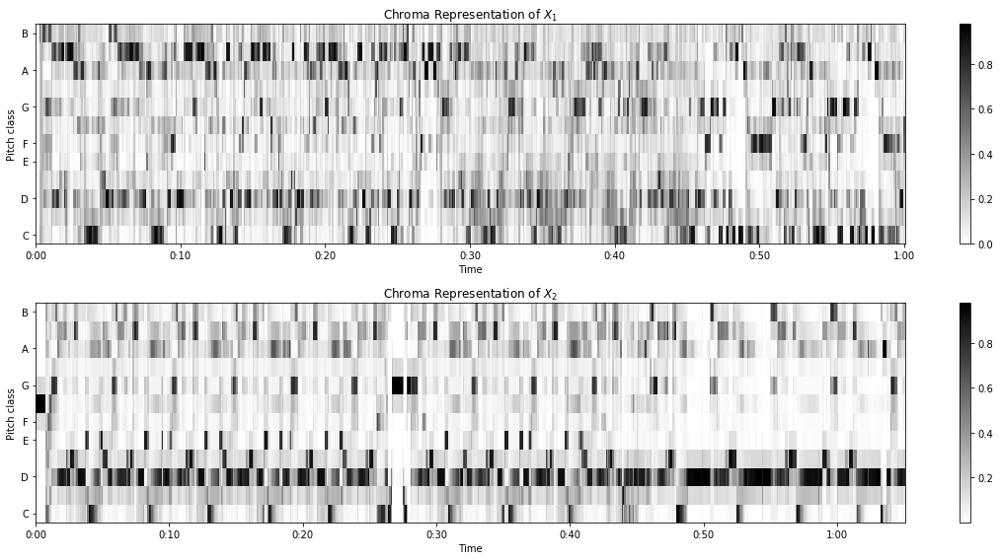

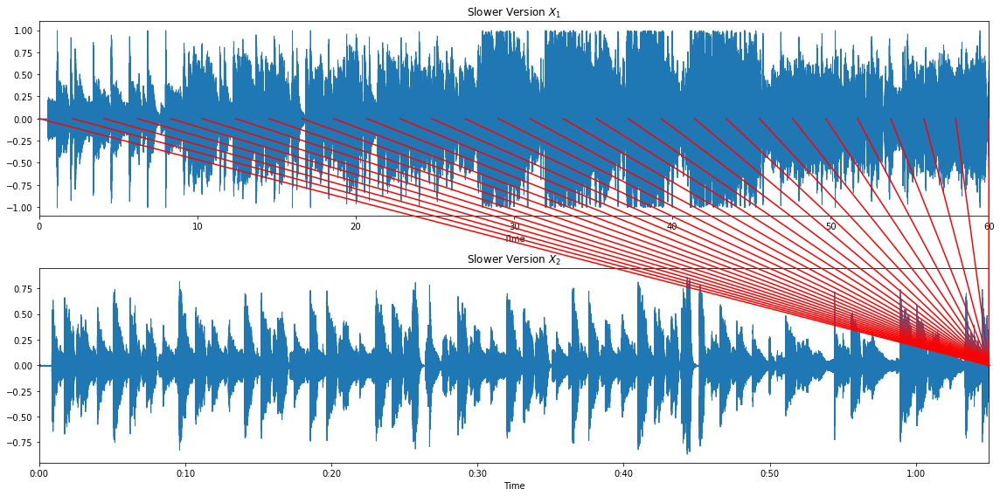

In [17]:
#Alternative DTW program

def alternative_dtw(x_1, x_2, fs):
    x_1, fs = librosa.load('havana_0_60.wav')
    plt.figure(figsize=(16, 4))
    librosa.display.waveplot(x_1, sr=fs)
    plt.title('Slower Version $X_1$')
    plt.tight_layout()
    
    x_2, fs = librosa.load('havana_7_72.wav')
    plt.figure(figsize=(16, 4))
    librosa.display.waveplot(x_2, sr=fs)
    plt.title('Faster Version $X_2$')
    plt.tight_layout()
    
    n_fft = 4410
    hop_size = 2205

    x_1_chroma = librosa.feature.chroma_stft(y=x_1, sr=fs, tuning=0, norm=2,
                                             hop_length=hop_size, n_fft=n_fft)
    x_2_chroma = librosa.feature.chroma_stft(y=x_2, sr=fs, tuning=0, norm=2,
                                             hop_length=hop_size, n_fft=n_fft)

    plt.figure(figsize=(16, 8))
    plt.subplot(2, 1, 1)
    plt.title('Chroma Representation of $X_1$')
    librosa.display.specshow(x_1_chroma, x_axis='time',
                             y_axis='chroma', cmap='gray_r', hop_length=hop_size)
    plt.colorbar()
    plt.subplot(2, 1, 2)
    plt.title('Chroma Representation of $X_2$')
    librosa.display.specshow(x_2_chroma, x_axis='time',
                             y_axis='chroma', cmap='gray_r', hop_length=hop_size)
    plt.colorbar()
    plt.tight_layout()
    
    D, wp = librosa.core.dtw(X=x_1_chroma, Y=x_2_chroma, metric='cosine')
    wp_s = np.asarray(wp) * hop_size / fs

#     fig = plt.figure(figsize=(10, 10))
#     ax = fig.add_subplot(111)
#     librosa.display.specshow(D, x_axis='time', y_axis='time',
#                              cmap='gray_r', hop_length=hop_size)
#     imax = ax.imshow(D, cmap=plt.get_cmap('gray_r'),
#                      origin='lower', interpolation='nearest', aspect='auto')
#     ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
#     plt.title('Warping Path on Acc. Cost Matrix $D$')
#     plt.colorbar()
    import matplotlib
    fig = plt.figure(figsize=(16, 8))

    # Plot x_1
    plt.subplot(2, 1, 1)
    librosa.display.waveplot(x_1, sr=fs)
    plt.title('Slower Version $X_1$')
    ax1 = plt.gca()

    # Plot x_2
    plt.subplot(2, 1, 2)
    librosa.display.waveplot(x_2, sr=fs)
    plt.title('Slower Version $X_2$')
    ax2 = plt.gca()

    plt.tight_layout()

    trans_figure = fig.transFigure.inverted()
    lines = []
    arrows = 30
    points_idx = np.int16(np.round(np.linspace(0, wp.shape[0] - 1, arrows)))

    # for tp1, tp2 in zip((wp[points_idx, 0]) * hop_size, (wp[points_idx, 1]) * hop_size):
    for tp1, tp2 in wp[points_idx] * hop_size / fs:
        # get position on axis for a given index-pair
        coord1 = trans_figure.transform(ax1.transData.transform([tp1, 0]))
        coord2 = trans_figure.transform(ax2.transData.transform([tp2, 0]))

        # draw a line
        line = matplotlib.lines.Line2D((coord1[0], coord2[0]),
                                       (coord1[1], coord2[1]),
                                       transform=fig.transFigure,
                                       color='r')
        lines.append(line)

    fig.lines = lines
    plt.tight_layout()
    
alternative_dtw(data, data2,sr)

Initial offset 0
length of original 1336320 length of modified 1433088
start: 1 end: 2 duration: 1 slope: 780.25
start: 3 end: 4 duration: 1 slope: 303.625
start: 5 end: 7 duration: 2 slope: 177.07777777777778
start: 8 end: 12 duration: 4 slope: 106.58833333333332
start: 13 end: 20 duration: 7 slope: 64.77783027516
start: 21 end: 33 duration: 12 slope: 39.69653358051067
start: 34 end: 54 duration: 20 slope: 24.496365659937894
start: 55 end: 89 duration: 34 slope: 15.122650403427857
start: 90 end: 142 duration: 52 slope: 9.494855322423975
start: 143 end: 232 duration: 89 slope: 5.964623148540245
start: 233 end: 370 duration: 137 slope: 3.744584727992416
start: 371 end: 589 duration: 218 slope: 2.351794477577957
start: 590 end: 1022 duration: 432 slope: 1.4438656215639012
start: 1023 end: 2610 duration: 1587 slope: 0.8444843022557653


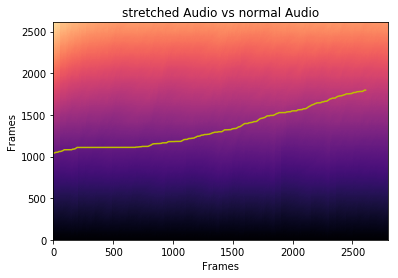

In [35]:
def stretchDetector2(original, modified):
    D, wp = librosa_dtw(original, modified, "stretched Audio vs normal Audio", 'y')
    slopeList = []
    wpr = wp[::-1]
    starting_threshold = 50
    startFrame = wpr[0]
    # tuple of y-x
    interval = []
    if abs(startFrame[1]) > starting_threshold:
        interval.append([0, startFrame[1], 0])
    x_diff = startFrame[1]
    print("Initial offset", x_diff)
    start_slope_idx = 0
    start_slope = -1
    for idx in range(1,len(wpr)):
        curr_y, curr_x = wpr[idx]
        curr_x -= x_diff
        if curr_x == 0:
            continue
        curr_slope = curr_y / curr_x
        if start_slope == -1:
            start_slope = curr_slope
            start_slope_idx = wpr[idx][1]
            slopeList.append(start_slope)
        elif 0.8< curr_slope / start_slope < 1.2: # approx the same
            slopeList.append(curr_slope)
            start_slope = np.mean(slopeList)
        else:
            slopeList.append(curr_slope)
            start_slope = np.mean(slopeList)            
            interval.append([start_slope_idx, wpr[idx][1], start_slope])
            start_slope = -1
            slopeList = []
            start_slope_idx = 0
    if start_slope != -1:
        interval.append([start_slope_idx, wpr[idx][1], start_slope])
        start_slope = -1
        start_slope_idx = 0    

    return (interval)

original = data_chroma['chroma_cq']
modified = data2_chroma['chroma_cq']
# noise = np.random.rand(12, 200)
# modified = np.concatenate((noise, modified), axis=1) 


# intervals = stretchDetector2(original, modified)
intervals = stretchDetector2(modified,original)
print("length of original", len(data), "length of modified", len(data2))
for i in intervals:
    print("start:", i[0], "end:", i[1], "duration:", i[1] - i[0], "slope:", i[2] )
        


In [33]:
def restretch(audio_to_use, intervals):
    restretch_data = np.empty(0)
    off_set = 0
    for interval in intervals: 
        _start = interval[0]
        _end = interval[1]
        ratio = interval[2]
        if _end - _start == 0: #if the slope is reaching toward 0 then just skip the part
            print("Skipping part with 0 duration", "start", _start,"end", _end )
            off_set += _end - _start
            continue

        sample_start = librosa.frames_to_samples(_start - off_set)
        sample_end = librosa.frames_to_samples(_end - off_set) 

        if ratio < 0.05:
            print("Adding noise with duration", librosa.frames_to_time(_end - _start))
            noise = np.zeros(sample_end - sample_start)
            restretch_data = np.concatenate((restretch_data, noise), axis=0)
        else:
            print("sample_start", _start, "sample_end", _end, "duration",  librosa.frames_to_time(_end - _start))
            restretch_interval = librosa.effects.time_stretch(audio_to_use[sample_start:sample_end], 1 / ratio)
            print("length of section (frame):", len(restretch_interval))
            restretch_data = np.concatenate((restretch_data, restretch_interval), axis=0)
        print("length so far in restretch_data:", len(restretch_data))
    print("Final duration in second", len(restretch_data) / sr)
    return restretch_data

restretch_data = restretch(data2, intervals)

sample_start 45 sample_end 46 duration 0.023219954648526078
length of section (frame): 15360
length so far in restretch_data: 15360
sample_start 47 sample_end 48 duration 0.023219954648526078
length of section (frame): 6656
length so far in restretch_data: 22016
sample_start 49 sample_end 52 duration 0.06965986394557823
length of section (frame): 8192
length so far in restretch_data: 30208
sample_start 53 sample_end 61 duration 0.18575963718820862
length of section (frame): 11264
length so far in restretch_data: 41472
sample_start 62 sample_end 118 duration 1.3003174603174603
length of section (frame): 41984
length so far in restretch_data: 83456
sample_start 119 sample_end 303 duration 4.272471655328798
length of section (frame): 113152
length so far in restretch_data: 196608
sample_start 303 sample_end 328 duration 0.5804988662131519
length of section (frame): 23040
length so far in restretch_data: 219648
Skipping part with 0 duration start 328 end 328
sample_start 328 sample_end 803

In [34]:
#sample restretch
# restretch_data = librosa.effects.time_stretch(restretch_data, 2)

ipd.Audio(restretch_data, rate=sr)

In [35]:
#Now add the stretch and restretch together

if restretch_data.shape[0] < data.shape[0]:
    padding = np.zeros(data.shape[0] - restretch_data.shape[0])
    print(data.shape, restretch_data.shape, padding.shape)
    print(data.shape[0] / sr, restretch_data.shape[0] / sr , padding.shape[0] / sr)
    
    final_mash = np.concatenate((restretch_data, padding), axis=0)
    final_mash  = final_mash / final_mash.max() + data/data.max()
    final_mash = 0.5 * final_mash/final_mash.max()  
    
elif restretch_data.shape[0] > data.shape[0]:
    padding = np.zeros(restretch_data.shape[0] - data.shape[0])
    print(data.shape, restretch_data.shape, padding.shape)
    print(data.shape[0] / sr, restretch_data.shape[0] / sr , padding.shape[0] / sr)
    final_mash = np.concatenate((data, padding), axis=0)    
    final_mash  = final_mash / final_mash.max() + restretch_data/data.max()
    final_mash = 0.5 * final_mash/final_mash.max()
    

print(len(final_mash))


(1323000,) (1340416,) (17416,)
60.0 60.78984126984127 0.7898412698412698
1340416


In [36]:
ipd.Audio(final_mash, rate=sr)